In [2]:
import pandas as pd
from tqdm.auto import tqdm
tqdm.pandas(desc='Progress')
import plotly.express as px

In [3]:
from datasets import load_dataset
dataset = load_dataset("khalidalt/HuffPost")
data = pd.DataFrame(dataset['test'])
data["full_review"] = data['headline'] + " " + data['short_description']
data.head()

,category,headline,authors,link,short_description,date,label,full_review
0,CRIME,There Were 2 Mass Shootings In Texas Last Week...,Melissa Jeltsen,https://www.huffingtonpost.com/entry/texas-ama...,She left her husband. He killed their children...,2018-05-26,20,There Were 2 Mass Shootings In Texas Last Week...
1,ENTERTAINMENT,Will Smith Joins Diplo And Nicky Jam For The 2...,Andy McDonald,https://www.huffingtonpost.com/entry/will-smit...,Of course it has a song.,2018-05-26,2,Will Smith Joins Diplo And Nicky Jam For The 2...
2,ENTERTAINMENT,Hugh Grant Marries For The First Time At Age 57,Ron Dicker,https://www.huffingtonpost.com/entry/hugh-gran...,The actor and his longtime girlfriend Anna Ebe...,2018-05-26,2,Hugh Grant Marries For The First Time At Age 5...
3,ENTERTAINMENT,Jim Carrey Blasts 'Castrato' Adam Schiff And D...,Ron Dicker,https://www.huffingtonpost.com/entry/jim-carre...,The actor gives Dems an ass-kicking for not fi...,2018-05-26,2,Jim Carrey Blasts 'Castrato' Adam Schiff And D...
4,ENTERTAINMENT,Julianna Margulies Uses Donald Trump Poop Bags...,Ron Dicker,https://www.huffingtonpost.com/entry/julianna-...,"The ""Dietland"" actress said using the bags is ...",2018-05-26,2,Julianna Margulies Uses Donald Trump Poop Bags...


In [4]:
# remove NULL Values from data
data = data[pd.notnull(data['full_review'])]

In [5]:
data['len'] = data['full_review'].apply(lambda s : len(s))

Length Distribution

In [10]:
# data['len'].plot.hist(bins=100, title="Review Length Distribution", figsize=(10,5), xlabel="Length", ylabel="Frequency")
fig = px.histogram(data, x="len", title="Sentence Distribution", nbins=100, labels={'len':'Length of Sentences'})
fig.update_layout(yaxis_title='No of Datapoints', xaxis_title='Sentence Length')
fig.update_layout(title_x=0.5)
fig.show()

Target Class Distribution

In [11]:
# Preprocessing Y Column
# We are only going to be classifying categorys for which the count of reviews are more than 3000.
count_df = data[['category','full_review']].groupby('category').aggregate({'full_review':'count'}).reset_index().sort_values('full_review',ascending=False)
count_df

,category,full_review
24,POLITICS,32739
37,WELLNESS,17827
10,ENTERTAINMENT,16058
34,TRAVEL,9887
30,STYLE & BEAUTY,9649
22,PARENTING,8677
16,HEALTHY LIVING,6694
25,QUEER VOICES,6314
13,FOOD & DRINK,6226
3,BUSINESS,5937


In [12]:
target_categorys = count_df[count_df['full_review']>0]['category'].values

In [13]:
def category_parser(x):
    if x in target_categorys:
        return x
    else:
        return "OTHER"
    
data['category'] = data['category'].apply(lambda x: category_parser(x)) 

In [14]:
data = data[data['category']!='OTHER']

In [26]:
fig = px.bar(count_df[count_df['full_review']>4000],x='category',y='full_review', title="News Distribution per Category", labels={'full_review':'Datapoints','category':'Category'})
fig.update_layout(title_x=0.5)
fig.show()

In [16]:
data['category'].unique()

array(['CRIME', 'ENTERTAINMENT', 'WORLD NEWS', 'IMPACT', 'POLITICS',
       'WEIRD NEWS', 'BLACK VOICES', 'WOMEN', 'COMEDY', 'QUEER VOICES',
       'SPORTS', 'BUSINESS', 'TRAVEL', 'MEDIA', 'TECH', 'RELIGION',
       'SCIENCE', 'LATINO VOICES', 'EDUCATION', 'COLLEGE', 'PARENTS',
       'ARTS & CULTURE', 'STYLE', 'GREEN', 'TASTE', 'HEALTHY LIVING',
       'THE WORLDPOST', 'GOOD NEWS', 'WORLDPOST', 'FIFTY', 'ARTS',
       'WELLNESS', 'PARENTING', 'HOME & LIVING', 'STYLE & BEAUTY',
       'DIVORCE', 'WEDDINGS', 'FOOD & DRINK', 'MONEY', 'ENVIRONMENT',
       'CULTURE & ARTS'], dtype=object)

Average Word Length Distribution per Class

In [28]:
fig = px.bar(data.groupby('category')['len'].mean().reset_index().sort_values(by='len',ascending=False),x='category',y='len',title="Average Review Length Per Category", labels={'len':'Length', 'category':'Category'})
fig.update_layout(title_x=0.5)
fig.show()

Word Cloud

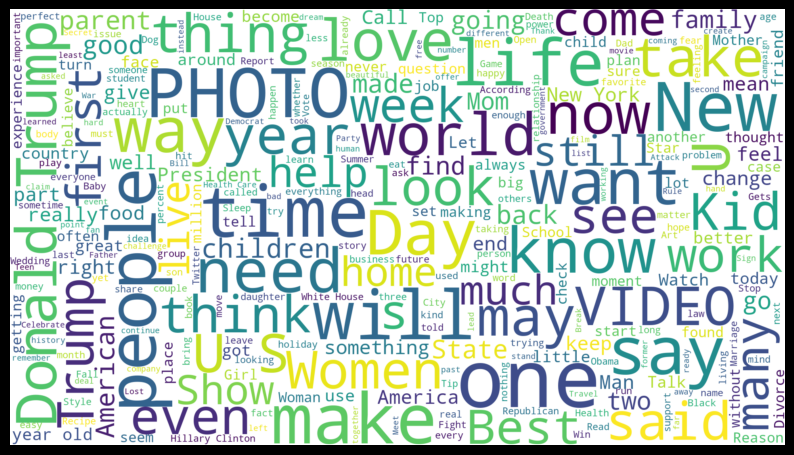

In [30]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import matplotlib.pyplot as plt

# Start with one review:
text = " ".join(review for review in data.full_review)

# Create and generate a word cloud image:
def make_wordcloud(words,title):
    cloud = WordCloud(width=1920, height=1080,max_font_size=200, max_words=300, background_color="white").generate(words)
    plt.figure(figsize=(10,10))
    plt.imshow(cloud, interpolation="bilinear")
    plt.axis("off") 
    plt.show()

# Display the generated image:
make_wordcloud(text,"All Reviews")

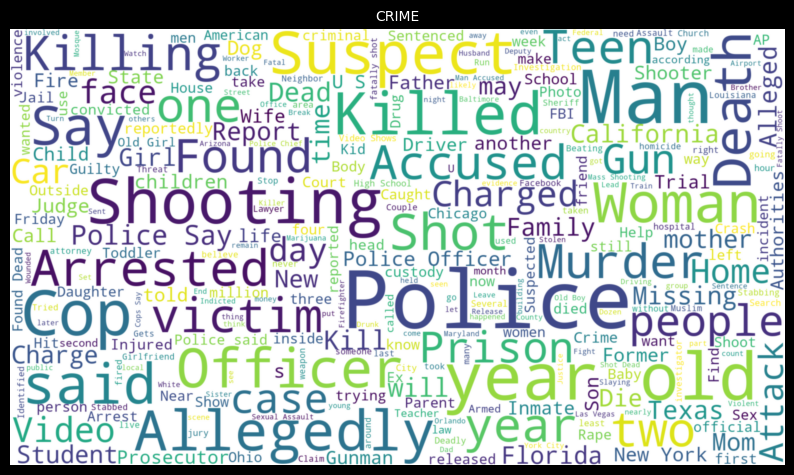

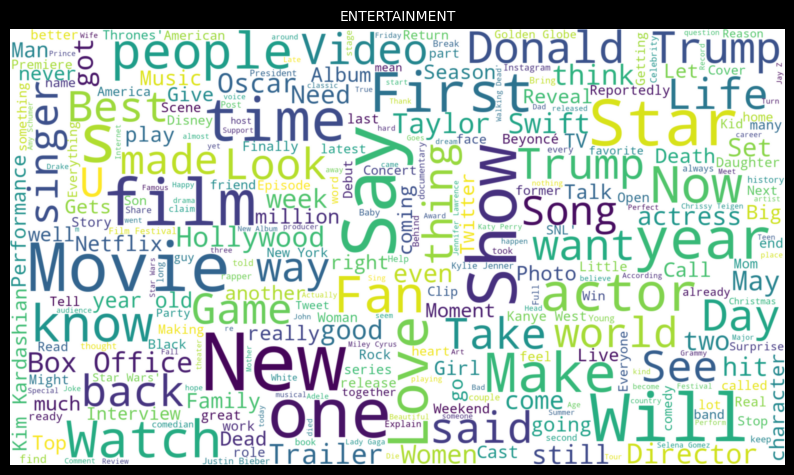

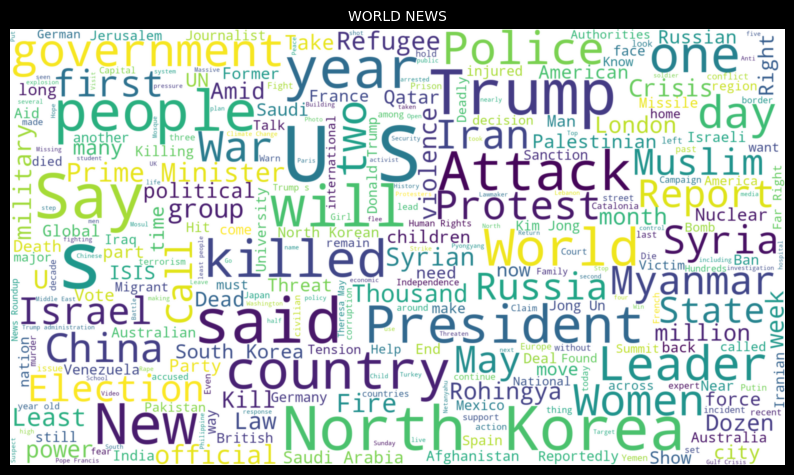

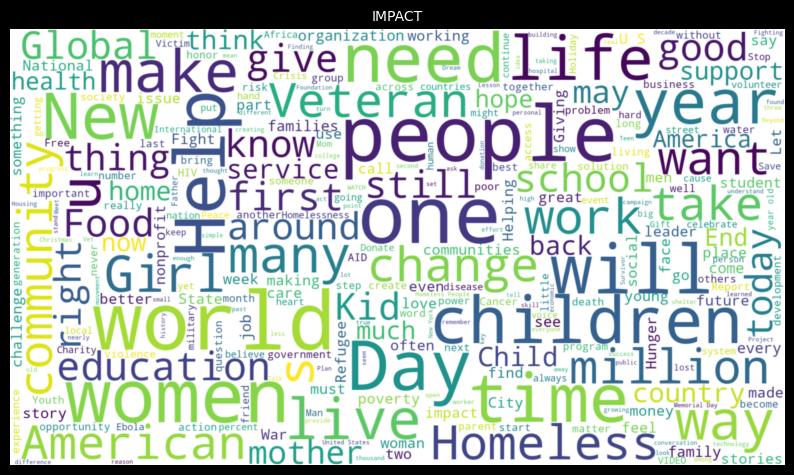

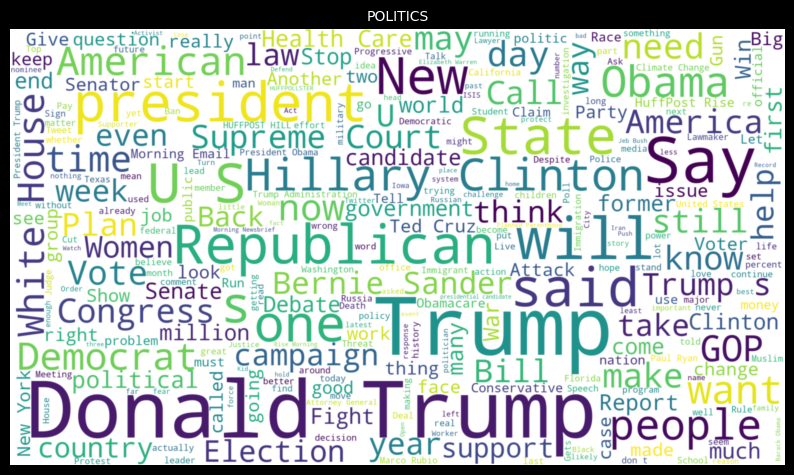

...

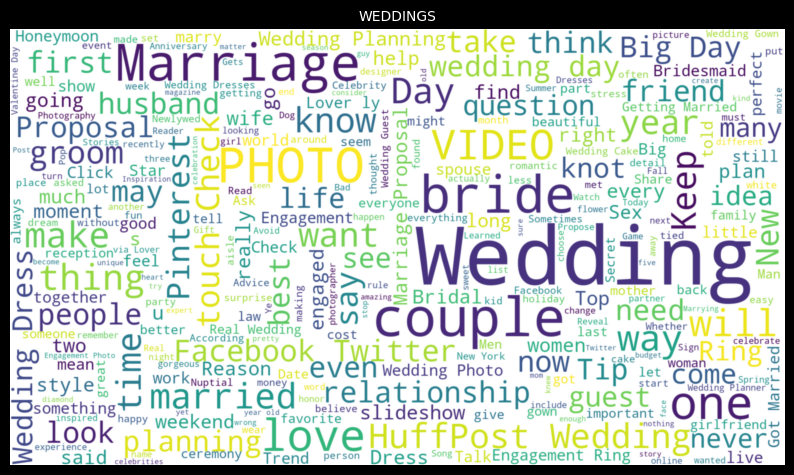

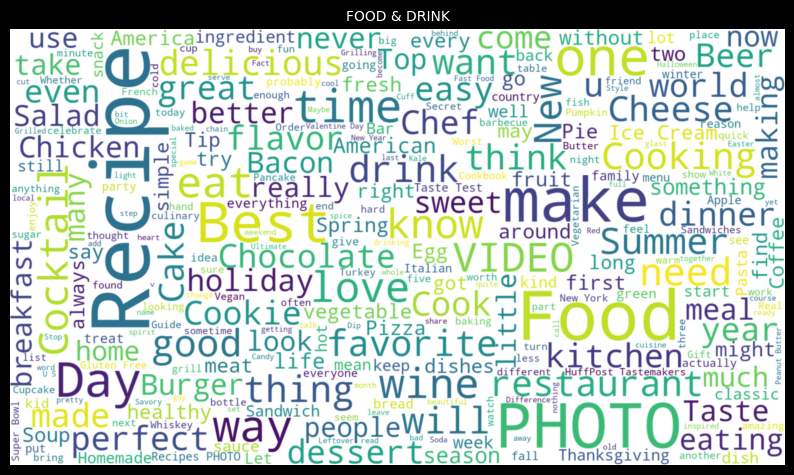

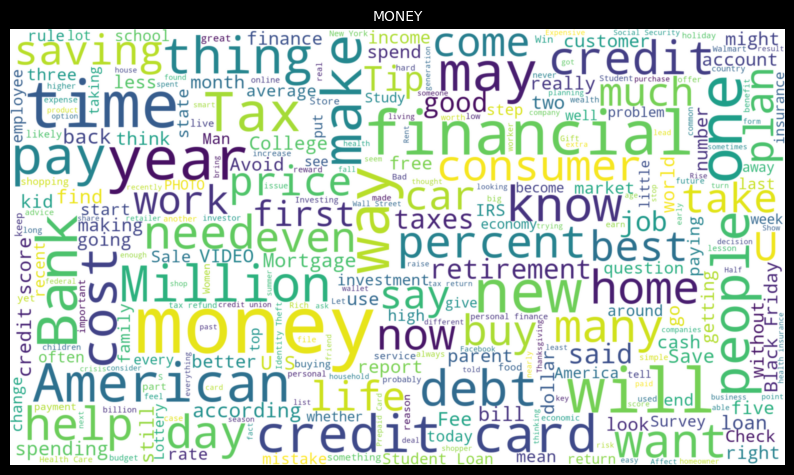

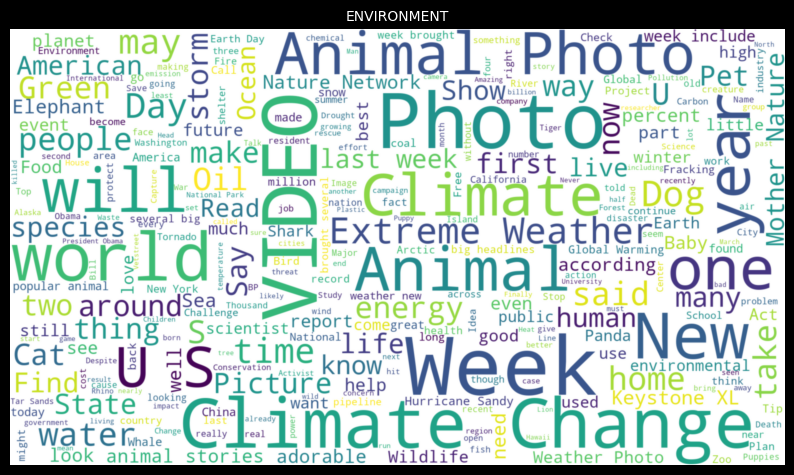

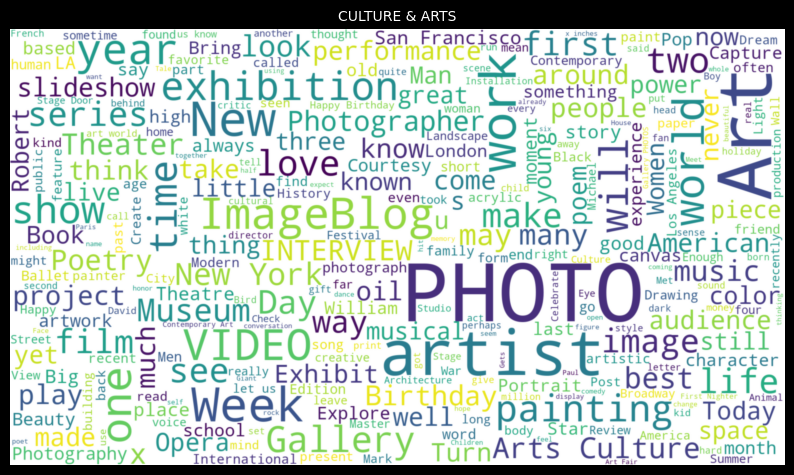

In [17]:
# make word cloud for top 10 categorys
for category in data['category'].unique():
    text = " ".join(review for review in data[data['category']==category].full_review)
    make_wordcloud(text,category)

Term Frequency Distribution

In [14]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Create a vectorizer object to generate term document counts
tfidf = TfidfVectorizer(analyzer='word')

text = tfidf.fit_transform(data['full_review'])
df_tfidf = pd.DataFrame(text.toarray(), columns=tfidf.get_feature_names_out())
df_tfidf.index = data.index
df_tfidf.head()

,00,000,0000,00064,000th,000x,001,0010,0011,002,...,семья,финансирования,харьковского,আইভ,ಠ_ಠ,ᵒᴥᵒᶅ,ﬁnd,ﬁrst,ﬁx,ﬂavors
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Correlation Matrix Heatmap

In [15]:
# import seaborn as sns
# import numpy as np

# data_new = df_tfidf[:100]
# plt.figure(figsize=(16, 6))
# heatmap = sns.heatmap(data_new.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
# heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':18}, pad=12);
# # save heatmap as .png file
# # dpi - sets the resolution of the saved image in dots/inches
# # bbox_inches - when set to 'tight' - does not allow the labels to be cropped
# plt.savefig('heatmap.png', dpi=300, bbox_inches='tight')
